# Autotagging Piano Roll Midi com e sem ruído

In [1]:
import os
import pandas as pd
import pretty_midi
import numpy as np
import h5py
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader

FS = 100
SAMPLE_MID_OUTPUT = "output.mid"
SAMPLE_NUMBER = 17
FS_AUDIO = 22050

NUM_SEGMENTS_MIN = 5
NUM_SEGMENTS_MAX = 10 
SEGMENT_LENGTH = FS * 10

# Noise parameters
NOTE_DURATION_VARIATION = 5
INTENSITY_VARIATION = 1
RANDOM_NOTE_PROBABILITY = 0.01
DURATION_NOTE_PROBABILITY = 0.1
INTENSE_NOTE_PROBABILITY = 0.01

## Extração dos dados do The Lakh MIDI Dataset matched para pkl

Foram extraídos dados midi de uma amostra do dataset e salvos em arquivos pickles.
Os dados salvos foram segmentos de 10 segundos de piano roll e as tags correspondentes da música com os respectivos pesos das tags.
Para cada música foram retirados entre 5 e 10 segmentos.

In [2]:
import pretty_midi
import numpy as np
import pandas as pd
import os
import h5py
import random

def extract_midi_features_with_piano_roll(midi_file, file_path_h5, fs=FS):
    try:
        midi_data = pretty_midi.PrettyMIDI(midi_file)
        piano_roll = midi_data.get_piano_roll(fs=fs)

        total_frames = piano_roll.shape[1]

        # Se a música for menor que 10s, descarta
        if total_frames < SEGMENT_LENGTH:
            print(f"Música muito curta ({total_frames / fs:.2f}s), ignorando: {midi_file}")
            return None
        
        # Determinar número de segmentos a extrair
        num_segments = random.randint(NUM_SEGMENTS_MIN, NUM_SEGMENTS_MAX)

        # Definir intervalos de início sem sobreposição
        possible_starts = np.linspace(0, total_frames - SEGMENT_LENGTH, num_segments, dtype=int)

        piano_roll_segments = []
        for start in possible_starts:
            end = start + SEGMENT_LENGTH
            piano_roll_segments.append(piano_roll[:, start:end])

        # Abrir o arquivo H5 para obter os artist_terms e seus pesos
        with h5py.File(file_path_h5, 'r') as h5_file:
            artist_terms = h5_file['metadata']['artist_terms'][:]
            artist_terms_weight = h5_file['metadata']['artist_terms_weight'][:]

        artist_terms = [term.decode('utf-8') for term in artist_terms]
        artist_terms_dict = {term: weight for term, weight in zip(artist_terms, artist_terms_weight)}

        return {
            "piano_roll_segments": piano_roll_segments,  # Lista de segmentos
            **artist_terms_dict,
        }

    except Exception as e:
        print(f"Erro ao processar {midi_file}: {e}")
        return None

def create_midi_dataframe_with_piano_roll(source_dir):
    midi_data = []
    
    for root, _, files in os.walk(source_dir):
        for file in files:
            if file.endswith(".mid") or file.endswith(".midi"):
                file_path = os.path.join(root, file)
                file_path_h5 = root.replace("lmd_matched", "lmd_matched_h5") + ".h5"
                
                segments = extract_midi_features_with_piano_roll(file_path, file_path_h5)
                
                if segments is None:
                    continue  # Ignora músicas que não puderam ser processadas
                
                for segment in segments["piano_roll_segments"]:
                    entry = {
                        "file_path": file_path,
                        "file_path_h5": file_path_h5,
                        "piano_roll_10s": segment,
                        **{k: v for k, v in segments.items() if k != "piano_roll_segments"},
                    }
                    midi_data.append(entry)  # Adiciona cada segmento como um exemplo separado

            break
    
    return pd.DataFrame(midi_data)

# Iterar sobre os diretórios e salvar os datasets
paths = ['A', 'B', 'C', 'D']
for i in paths:
    for j in paths:
        source_directory_midi = f"lmd_matched/lmd_matched/{i}/{j}"
        midi_df = create_midi_dataframe_with_piano_roll(source_directory_midi)
        midi_df.to_pickle(f"dbs/midi_dataset_with_piano_roll_{i}{j}.pkl")


/home/junio/.local/lib/python3.10/site-packages/pretty_midi/pretty_midi.py:100: RuntimeWarning: Tempo, Key or Time signature change events found on non-zero tracks.  This is not a valid type 0 or type 1 MIDI file.  Tempo, Key or Time Signature may be wrong.
  warnings.warn(


## Carregamento dos dados

Os arquivos pickle foram agrupados em uma única base de dados pandas

In [3]:
pickle_file = "dbs"

dfs = []

for file_name in os.listdir(pickle_file):
    if file_name.endswith('.pkl'): 
        file_path = os.path.join(pickle_file, file_name)
        df_ = pd.read_pickle(file_path) 
        dfs.append(df_)

df = pd.concat(dfs, ignore_index=True)
df = df.dropna(subset=['piano_roll_10s'])
df = df.fillna(0)
df

,file_path,file_path_h5,piano_roll_10s,reggaeton,ballad,progressive house,europop,trance,hard house,progressive trance,...,bounce,japanese punk rock,south carolina,marcha,praise & worship,modern worship,oregon,tooth and nail records,christian music,rockin praise
0,lmd_matched/lmd_matched/B/B/U/TRBBUMN128F93089...,lmd_matched_h5/lmd_matched_h5/B/B/U/TRBBUMN128...,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",1.0,0.979026,0.9694,0.948639,0.931161,0.899387,0.883555,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,lmd_matched/lmd_matched/B/B/U/TRBBUMN128F93089...,lmd_matched_h5/lmd_matched_h5/B/B/U/TRBBUMN128...,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",1.0,0.979026,0.9694,0.948639,0.931161,0.899387,0.883555,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,lmd_matched/lmd_matched/B/B/U/TRBBUMN128F93089...,lmd_matched_h5/lmd_matched_h5/B/B/U/TRBBUMN128...,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",1.0,0.979026,0.9694,0.948639,0.931161,0.899387,0.883555,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,lmd_matched/lmd_matched/B/B/U/TRBBUMN128F93089...,lmd_matched_h5/lmd_matched_h5/B/B/U/TRBBUMN128...,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",1.0,0.979026,0.9694,0.948639,0.931161,0.899387,0.883555,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,lmd_matched/lmd_matched/B/B/U/TRBBUMN128F93089...,lmd_matched_h5/lmd_matched_h5/B/B/U/TRBBUMN128...,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",1.0,0.979026,0.9694,0.948639,0.931161,0.899387,0.883555,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2664,lmd_matched/lmd_matched/A/C/P/TRACPDO128F9333A...,lmd_matched_h5/lmd_matched_h5/A/C/P/TRACPDO128...,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",0.0,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2665,lmd_matched/lmd_matched/A/C/P/TRACPDO128F9333A...,lmd_matched_h5/lmd_matched_h5/A/C/P/TRACPDO128...,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",0.0,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2666,lmd_matched/lmd_matched/A/C/P/TRACPDO128F9333A...,lmd_matched_h5/lmd_matched_h5/A/C/P/TRACPDO128...,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",0.0,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2667,lmd_matched/lmd_matched/A/C/P/TRACPDO128F9333A...,lmd_matched_h5/lmd_matched_h5/A/C/P/TRACPDO128...,"[[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0,...",0.0,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


## Funções auxiliares

Função que transforma o arquivo midi em um audio

In [4]:
import pretty_midi
from IPython.display import Audio

def midi_to_audio(midi_file, fs=FS_AUDIO):  # Usando uma taxa de amostragem mais alta
    try:
        # Carregar o arquivo MIDI
        midi_data = pretty_midi.PrettyMIDI(midi_file)

        # Gerar a MIDI a partir do arquivo MIDI
        midi = pretty_midi.PrettyMIDI()

        # Criar uma nova instrumento para o piano
        instrument = pretty_midi.Instrument(program=pretty_midi.instrument_name_to_program('Acoustic Grand Piano'))

        # Copiar todas as notas dos instrumentos presentes no arquivo midi original para o novo instrumento
        for instrument_data in midi_data.instruments:
            for note in instrument_data.notes:
                start_time = note.start
                end_time = note.end
                pitch = note.pitch
                velocity = note.velocity

                # Adicionar as notas ao nosso novo instrumento
                new_note = pretty_midi.Note(velocity=velocity, pitch=pitch, start=start_time, end=end_time)
                instrument.notes.append(new_note)

        # Adicionar o instrumento à MIDI
        midi.instruments.append(instrument)

        # Garantir que o áudio gerado não ultrapasse o tempo real do arquivo MIDI
        midi_length = midi.get_end_time()  # Duração total do MIDI

        # Gerar áudio usando a função fluidsynth
        audio = midi.fluidsynth(fs=fs)

        return audio  # Retorna o áudio gerado
    except Exception as e:
        print(f"Erro ao gerar áudio do arquivo MIDI: {e}")
        return None

Função que adiciona ruído ao piano roll

In [5]:
def add_noise_to_pianoroll(piano_roll, 
                           fs=FS, 
                           note_duration_variation=NOTE_DURATION_VARIATION, 
                           intensity_variation=INTENSITY_VARIATION, 
                           random_note_probability=RANDOM_NOTE_PROBABILITY, 
                           duration_note_probability=DURATION_NOTE_PROBABILITY, 
                           intense_note_probability=INTENSITY_VARIATION):

    new_piano_roll = np.copy(piano_roll)
    max = np.max(new_piano_roll)
    num_notes = new_piano_roll.shape[0]
    num_frames = new_piano_roll.shape[1]
    
    for i in range(num_notes):
        for j in range(num_frames):
            if(new_piano_roll[i, j] == 0):
                if np.random.rand() < random_note_probability: 
                    new_piano_roll[i, j] = np.random.uniform(0, max) 
    
    for i in range(num_notes):
        for j in range(num_frames):
            if new_piano_roll[i, j] > 0: 
                if np.random.rand() < duration_note_probability:
                    if j + 10 < num_frames:  
                        new_piano_roll[i, j:j + note_duration_variation] = new_piano_roll[i, j] 
                    else:
                        new_piano_roll[i, j:] = new_piano_roll[i, j]  
    
    for i in range(num_notes):
        for j in range(num_frames):
            if new_piano_roll[i, j] > 0: 
                if np.random.rand() < intense_note_probability:
                    variation = np.random.uniform(0, 1 + intensity_variation)
                    new_piano_roll[i, j] *= variation 

    new_piano_roll = np.clip(new_piano_roll, 0, max)
    
    return new_piano_roll

Função que printa 2 piano rolls

In [72]:
def print_pianoroll_normal_noised(piano_roll, noisy_piano_roll):

    # Exibir ambos os piano rolls (original e com ruído) lado a lado
    fig, axes = plt.subplots(1, 2, figsize=(12, 4))  # Cria uma figura com 2 subplots lado a lado

    # Plotar o piano roll original
    cax0 = axes[0].imshow(piano_roll, aspect='auto', cmap='gray_r', origin='lower', interpolation='nearest')
    axes[0].set_title('Piano Roll Original')
    axes[0].set_xlabel('Tempo')
    axes[0].set_ylabel('Notas')
    fig.colorbar(cax0, ax=axes[0], label='Atividade (nota ativa)')

    # Plotar o piano roll com ruído
    cax1 = axes[1].imshow(noisy_piano_roll, aspect='auto', cmap='gray_r', origin='lower', interpolation='nearest')
    axes[1].set_title('Piano Roll com Ruído')
    axes[1].set_xlabel('Tempo')
    axes[1].set_ylabel('Notas')
    fig.colorbar(cax1, ax=axes[1], label='Atividade (nota ativa)')

    # Ajuste automático do layout
    plt.tight_layout()

    # Exibir os gráficos
    plt.show()

def print_pianoroll(piano_roll, title):

    # Exibir apenas o piano roll original
    plt.figure()  # Cria uma figura com tamanho adequado

    # Plotar o piano roll original
    cax0 = plt.imshow(piano_roll, aspect='auto', cmap='gray_r', origin='lower', interpolation='nearest')
    plt.title(title)
    plt.xlabel('Tempo')
    plt.ylabel('Notas')
    plt.colorbar(cax0)

    # Ajuste automático do layout
    plt.tight_layout()

    # Exibir o gráfico
    plt.show()

Função que tranforma piano roll em um arquivo midi

In [7]:
import pretty_midi
import numpy as np

def pianoroll_to_midi(piano_roll, fs=FS, output_midi_path=SAMPLE_MID_OUTPUT):
    try:
        # Criação de uma instância PrettyMIDI
        midi = pretty_midi.PrettyMIDI()
        
        # Criar uma nova instância de instrumento (piano)
        piano = pretty_midi.Instrument(program=pretty_midi.instrument_name_to_program('Acoustic Grand Piano'))

        # Percorrer as notas do piano roll
        num_notes, num_frames = piano_roll.shape
        for i in range(num_notes):
            for j in range(num_frames):
                if piano_roll[i, j] > 0:  # Se a nota está ativa
                    start_time = j / fs  # Tempo de início
                    end_time = (j + 1) / fs  # Tempo de término (duração da nota)
                    pitch = i + 21  # Mapeamento de índice de nota para pitch (padrão de 88 teclas)
                    
                    # Garantir que o pitch esteja dentro do intervalo válido (0 a 127)
                    if pitch < 0:
                        pitch = 0
                    elif pitch > 127:
                        pitch = 127
                    
                    note = pretty_midi.Note(velocity=100, pitch=pitch, start=start_time, end=end_time)  # Adiciona a nota
                    piano.notes.append(note)
        
        # Adicionar o instrumento ao arquivo MIDI
        midi.instruments.append(piano)
        
        # Salvar o arquivo MIDI
        midi.write(output_midi_path)
        print(f"MIDI salvo em: {output_midi_path}")
    except Exception as e:
        print(f"Erro ao converter piano roll para MIDI: {e}")




### Uso das funções

In [8]:
midi_file = df.iloc[SAMPLE_NUMBER, 0]

audio = midi_to_audio(midi_file, fs=FS_AUDIO)

Audio(audio, rate=FS_AUDIO)

In [9]:
piano_roll = df.iloc[SAMPLE_NUMBER, 2] 

midi = pianoroll_to_midi(piano_roll, fs=FS)

audio = midi_to_audio(SAMPLE_MID_OUTPUT, FS_AUDIO)

Audio(audio, rate=FS_AUDIO)

MIDI salvo em: output.mid


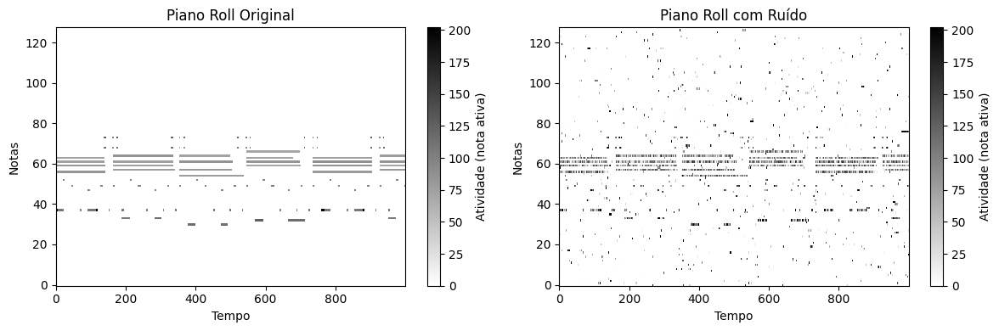

In [10]:
piano_roll_to_noise = df.iloc[SAMPLE_NUMBER, 2].copy()

noisy_piano_roll = add_noise_to_pianoroll(piano_roll_to_noise, fs=FS)

print_pianoroll_normal_noised(df.iloc[SAMPLE_NUMBER, 2], noisy_piano_roll)

In [11]:
pianoroll_to_midi(noisy_piano_roll, fs=FS, output_midi_path=SAMPLE_MID_OUTPUT)

audio = midi_to_audio(SAMPLE_MID_OUTPUT, fs=FS_AUDIO)

Audio(audio, rate=FS_AUDIO)

MIDI salvo em: output.mid


## Separação dos dados

In [12]:
tag_columns = df.columns[3:]
tag_columns

Index(['reggaeton', 'ballad', 'progressive house', 'europop', 'trance',
       'hard house', 'progressive trance', 'disco', 'italian disco',
       'dance music',
       ...
       'bounce', 'japanese punk rock', 'south carolina', 'marcha',
       'praise & worship', 'modern worship', 'oregon',
       'tooth and nail records', 'christian music', 'rockin praise'],
      dtype='object', length=1092)

Foram escolhidas as 30 colunas de tags com maior soma de pesos para treinar o modelo

In [13]:
top_30_columns = df[tag_columns].sum(axis=0).nlargest(30).index
top_30_columns

Index(['rock', 'pop', 'electronic', 'pop rock', 'jazz', 'ballad', 'disco',
       'hip hop', 'alternative rock', 'classic rock', 'soft rock', 'soul',
       'alternative', 'electro', 'soundtrack', 'downtempo', 'easy listening',
       'funk', 'techno', 'house', 'blues', 'folk', 'reggae', 'germany',
       'synthpop', 'singer-songwriter', 'united states', 'new wave', 'trance',
       'punk'],
      dtype='object')

In [14]:
df_filtrado = df.loc[:, ['file_path', 'file_path_h5', 'piano_roll_10s'] + list(top_30_columns)]
df_filtrado.shape

(2669, 33)

In [15]:
tag_columns = df_filtrado.columns[3:]
tag_columns_size = len(tag_columns)
print(tag_columns_size)

(df_filtrado[tag_columns].sum(axis=1) == 0).sum()
df_filtrado = df_filtrado[df_filtrado[tag_columns].sum(axis=1) != 0]

30


In [16]:
df_filtrado.shape

(2576, 33)

In [17]:
df_filtrado.columns

Index(['file_path', 'file_path_h5', 'piano_roll_10s', 'rock', 'pop',
       'electronic', 'pop rock', 'jazz', 'ballad', 'disco', 'hip hop',
       'alternative rock', 'classic rock', 'soft rock', 'soul', 'alternative',
       'electro', 'soundtrack', 'downtempo', 'easy listening', 'funk',
       'techno', 'house', 'blues', 'folk', 'reggae', 'germany', 'synthpop',
       'singer-songwriter', 'united states', 'new wave', 'trance', 'punk'],
      dtype='object')

In [18]:
df_filtrado = df_filtrado.sample(frac=1, random_state=42).reset_index(drop=True)

In [19]:
df_filtrado.iloc[:, 3:] = (df_filtrado.iloc[:, 3:] > 0).astype(int)

In [20]:
train_df = df_filtrado[:2000]
val_df = df_filtrado[2000:2300]
test_df = df_filtrado[2300:]

print(train_df.shape, val_df.shape, test_df.shape)

(2000, 33) (300, 33) (276, 33)


In [21]:
X_train = torch.tensor(train_df.iloc[:, 2].values.tolist()).unsqueeze(1) 
Y_train = torch.tensor(train_df[tag_columns].values)  

X_val = torch.tensor(val_df.iloc[:, 2].values.tolist()).unsqueeze(1) 
Y_val = torch.tensor(val_df[tag_columns].values)  

X_test = torch.tensor(test_df.iloc[:, 2].values.tolist()).unsqueeze(1) 
Y_test = torch.tensor(test_df[tag_columns].values) 

print(X_train.shape, Y_train.shape)
print(X_val.shape, Y_val.shape)
print(X_test.shape, Y_test.shape)

/tmp/ipykernel_32473/358963011.py:1: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:278.)
  X_train = torch.tensor(train_df.iloc[:, 2].values.tolist()).unsqueeze(1)


torch.Size([2000, 1, 128, 1000]) torch.Size([2000, 30])
torch.Size([300, 1, 128, 1000]) torch.Size([300, 30])
torch.Size([276, 1, 128, 1000]) torch.Size([276, 30])


In [22]:
batch_size = 100
X_batches = X_train.reshape((X_train.shape[0] // batch_size,
                             batch_size,
                             X_train.shape[1],
                             X_train.shape[2],
                             X_train.shape[3]))
Y_batches = Y_train.reshape((Y_train.shape[0] // batch_size,
                             batch_size,
                             Y_train.shape[1]))

In [23]:
Xb, Yb = X_batches[0], Y_batches[0]
Xb.shape

torch.Size([100, 1, 128, 1000])

In [24]:
Yb.shape

torch.Size([100, 30])

## Modelo

In [25]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


ResNet 18 pré treinada

In [26]:
import torchvision.models as models

class ResNetSpectrogram(nn.Module):
    def __init__(self, num_classes=30, input_channels=1):
        super(ResNetSpectrogram, self).__init__()

        self.resnet = models.resnet18(pretrained=True)
        
        self.resnet.conv1 = nn.Conv2d(input_channels, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
        
        self.resnet.fc = nn.Linear(self.resnet.fc.in_features, num_classes)

    def forward(self, x):
        x = self.resnet(x)
        x = torch.sigmoid(x)
        return x


In [27]:
model = ResNetSpectrogram().to(device)
model

/home/junio/.local/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/home/junio/.local/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet18_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet18_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


ResNetSpectrogram(
  (resnet): ResNet(
    (conv1): Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, 

Função de perda BCELoss

Otimizador Adagrad

Taxa de aprendizado 0.001

In [28]:
criterion = nn.BCELoss()
optimizer = torch.optim.Adagrad(model.parameters(), lr=0.001)

In [29]:
from sklearn.metrics import recall_score, f1_score, accuracy_score

epochs = 50

for epoch in range(epochs):

    model.train()
    epoch_loss = 0.
    for Xb, Yb in zip(X_batches, Y_batches):
        Xb = Xb.float().to(device)
        Yb = Yb.float().to(device)

        optimizer.zero_grad()

        outputs = model(Xb)

        loss = criterion(outputs, Yb)

        loss.backward()
        optimizer.step()

        epoch_loss += loss.item()

    if (epoch+1) in [1, 10, 20, 30, 40, 50]:
      print(f'Epoch {epoch} - Train Loss: {(epoch_loss/X_batches.shape[0]):.4f}', end='')

    with torch.no_grad():
        model.eval()

        X_val = X_val.float().to(device)
        Y_val = Y_val.float().to(device)

        outputs = model(X_val)
        loss_val = criterion(outputs, Y_val)
        epoch_loss = loss_val.item()
        
        preds = (outputs >= 0.3).float().cpu().numpy()
        Y_val_np = Y_val.cpu().numpy()

        rec = recall_score(Y_val_np, preds, average='micro')
        f1 = f1_score(Y_val_np, preds, average='micro')

        if (epoch+1) in [1, 10, 20, 30, 40, 50]:
          print(f' - Val Loss: {loss_val.item():.4f} - Recall: {rec:.4f} - F1: {f1:.4f}')

Epoch 0 - Train Loss: 0.5860 - Val Loss: 0.5612 - Recall: 0.6184 - F1: 0.5642
Epoch 9 - Train Loss: 0.1510 - Val Loss: 0.4115 - Recall: 0.7835 - F1: 0.7218
Epoch 19 - Train Loss: 0.0731 - Val Loss: 0.3930 - Recall: 0.7887 - F1: 0.7484
Epoch 29 - Train Loss: 0.0496 - Val Loss: 0.3853 - Recall: 0.7930 - F1: 0.7567
Epoch 39 - Train Loss: 0.0369 - Val Loss: 0.3813 - Recall: 0.7936 - F1: 0.7644
Epoch 49 - Train Loss: 0.0310 - Val Loss: 0.3868 - Recall: 0.7874 - F1: 0.7665


## Utilizando o modelo

In [30]:
def auto_tagging(id, df, model, topk, noised=False):

    row = df.iloc[id].copy()

    piano_roll = row['piano_roll_10s']
    if(noised):
        piano_roll = row['noisy_piano_roll']

    row = row.drop(['file_path', 'file_path_h5', 'piano_roll_10s'])

    if 'noisy_piano_roll' in row.index:
        row = row.drop('noisy_piano_roll')

    X_torch = torch.tensor(piano_roll).unsqueeze(0).unsqueeze(0).to(device).float()

    logit = model(X_torch)[0]

    idx_sorted = torch.argsort(logit, descending=True)
    idx_topk = idx_sorted[:topk]

    return row.iloc[idx_topk.cpu().numpy()].index, df.iloc[id][tag_columns][df.iloc[id][tag_columns] == 1].index.tolist()

In [31]:
import IPython.display as ipd

id = 2
tags, y = auto_tagging(id, test_df, model, 5)

midi_file = test_df.iloc[id, 0]
audio = midi_to_audio(midi_file, fs=FS_AUDIO)

print(tags)
print(y)
ipd.Audio(audio, rate=FS_AUDIO)

Index(['pop', 'rock', 'electronic', 'pop rock', 'disco'], dtype='object')
['rock', 'pop', 'pop rock', 'jazz', 'hip hop', 'alternative rock', 'soul', 'alternative', 'downtempo', 'easy listening', 'blues', 'folk', 'singer-songwriter', 'punk']


## Testes

In [32]:
import warnings
warnings.filterwarnings('ignore', category=UserWarning, module='pandas')

Precisão baseada nos top acertos

### Sem ruídos

k = 3, 0.8478260869565217
k = 5, 0.7768115942028986
k = 10, 0.6471014492753623


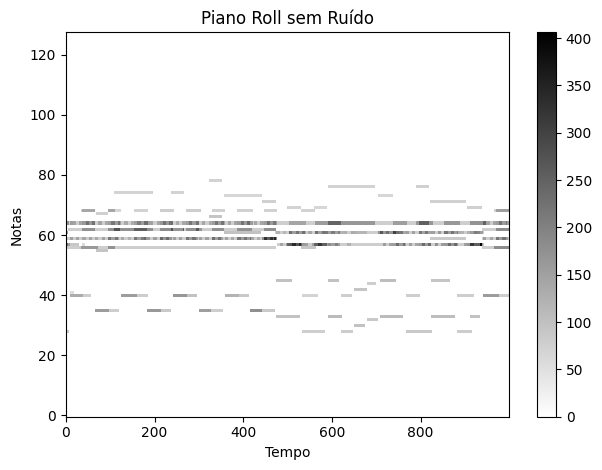

In [73]:
ks = [3, 5, 10]
for k in ks:
    acertos = 0
    total = k * len(test_df)
    for id in range(len(test_df)):
        tags, y = auto_tagging(id, test_df, model, k)
        if len(tags) < k:
            total -= k - len(tags)
        for tag in tags:
            if tag in y:
                acertos+=1
    print(f'k = {k}, {acertos/total}')

print_pianoroll(test_df.iloc[SAMPLE_NUMBER, 2], 'Piano Roll sem Ruído')

### Ruído

In [74]:
NOTE_DURATION_VARIATION = 5
INTENSITY_VARIATION = 3
RANDOM_NOTE_PROBABILITY = 0.02
DURATION_NOTE_PROBABILITY = 0.15
INTENSE_NOTE_PROBABILITY = 0.15

In [75]:
test_df['noisy_piano_roll'] = test_df['piano_roll_10s'].apply(lambda x: add_noise_to_pianoroll(x, fs=FS, note_duration_variation=NOTE_DURATION_VARIATION, 
                                                                                     intensity_variation=INTENSITY_VARIATION, 
                                                                                     random_note_probability=RANDOM_NOTE_PROBABILITY, 
                                                                                     duration_note_probability=DURATION_NOTE_PROBABILITY, 
                                                                                     intense_note_probability=INTENSE_NOTE_PROBABILITY))

/tmp/ipykernel_32473/1311944224.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_df['noisy_piano_roll'] = test_df['piano_roll_10s'].apply(lambda x: add_noise_to_pianoroll(x, fs=FS, note_duration_variation=NOTE_DURATION_VARIATION,


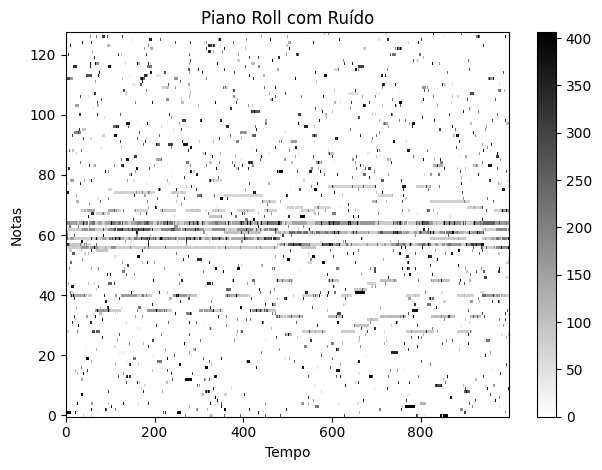

In [76]:
print_pianoroll(test_df.iloc[SAMPLE_NUMBER, -1], 'Piano Roll com Ruído')

In [77]:
ks = [3, 5, 10]
for k in ks:
    acertos = 0
    total = k * len(test_df)
    for id in range(len(test_df)):
        tags, y = auto_tagging(id, test_df, model, k, noised=True)

        if len(tags) < k:
            total -= k - len(tags)
        for tag in tags:
            if tag in y:
                acertos+=1
    print(f'k = {k}, {acertos/total}')


k = 3, 0.6135265700483091
k = 5, 0.5268115942028986
k = 10, 0.4398550724637681


### Ruído Nota

In [78]:
NOTE_DURATION_VARIATION = 0
INTENSITY_VARIATION = 0
DURATION_NOTE_PROBABILITY = 0
INTENSE_NOTE_PROBABILITY = 0

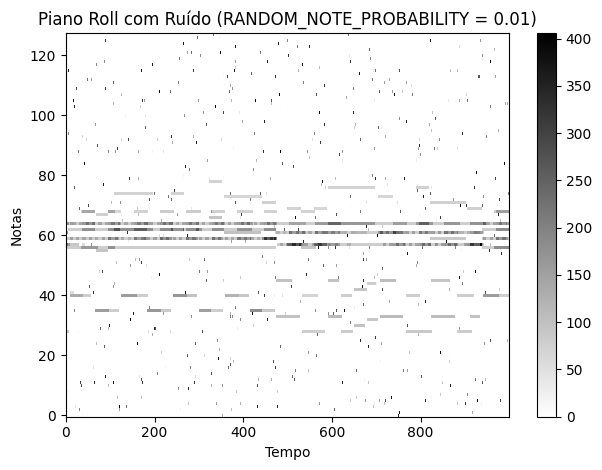

Testando RANDOM_NOTE_PROBABILITY = 0.01
k = 3, Precisão = 0.6509661835748792
k = 5, Precisão = 0.5565217391304348
k = 10, Precisão = 0.4543478260869565


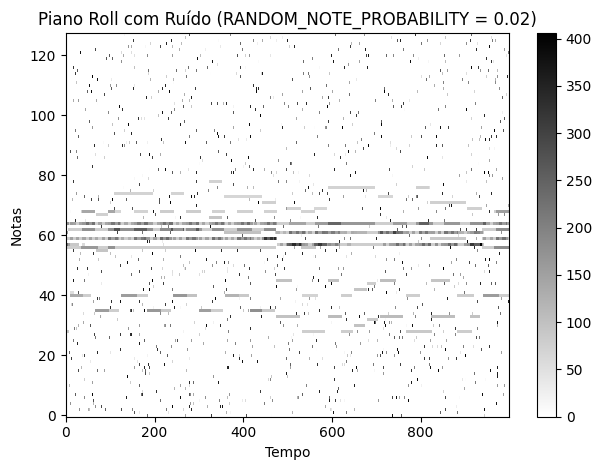

Testando RANDOM_NOTE_PROBABILITY = 0.02
k = 3, Precisão = 0.6268115942028986
k = 5, Precisão = 0.5413043478260869
k = 10, Precisão = 0.4528985507246377


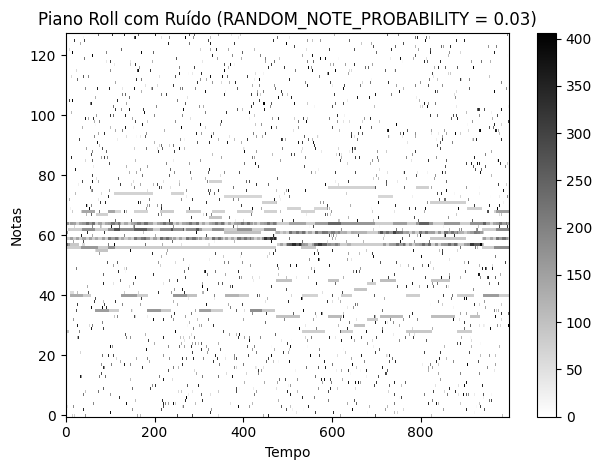

Testando RANDOM_NOTE_PROBABILITY = 0.03
k = 3, Precisão = 0.5954106280193237
k = 5, Precisão = 0.5202898550724637
k = 10, Precisão = 0.4460144927536232


In [79]:
random_note_probability = [0.01, 0.02, 0.03]

for RANDOM_NOTE_PROBABILITY in random_note_probability:
    test_df.loc[:, 'noisy_piano_roll'] = test_df['piano_roll_10s'].apply(
    lambda x: add_noise_to_pianoroll(x, fs=FS, note_duration_variation=NOTE_DURATION_VARIATION, 
                                    intensity_variation=INTENSITY_VARIATION, 
                                    random_note_probability=RANDOM_NOTE_PROBABILITY, 
                                    duration_note_probability=DURATION_NOTE_PROBABILITY, 
                                    intense_note_probability=INTENSE_NOTE_PROBABILITY)
    )
    
    print_pianoroll(test_df.iloc[SAMPLE_NUMBER, -1], 'Piano Roll com Ruído (RANDOM_NOTE_PROBABILITY = %.2f)' % RANDOM_NOTE_PROBABILITY)
    print(f'Testando RANDOM_NOTE_PROBABILITY = {RANDOM_NOTE_PROBABILITY}')
    
    ks = [3, 5, 10]
    for k in ks:
        acertos = 0
        total = k * len(test_df)
        for id in range(len(test_df)):
            tags, y = auto_tagging(id, test_df, model, k, noised=True)

            if len(tags) < k:
                total -= k - len(tags)
            for tag in tags:
                if tag in y:
                    acertos += 1
        print(f'k = {k}, Precisão = {acertos/total}')


### Ruído Duração

In [80]:
INTENSITY_VARIATION = 0
RANDOM_NOTE_PROBABILITY = 0
INTENSE_NOTE_PROBABILITY = 0

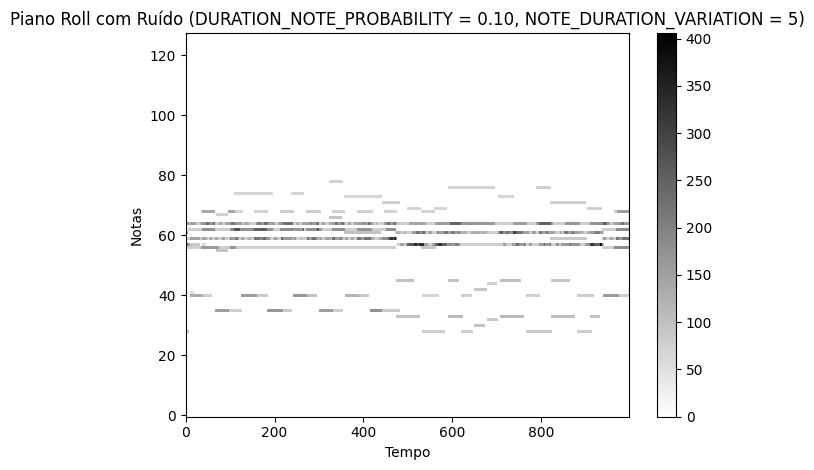

Testando DURATION_NOTE_PROBABILITY = 0.1, NOTE_DURATION_VARIATION = 5
k = 3, Precisão = 0.8538647342995169
k = 5, Precisão = 0.782608695652174
k = 10, Precisão = 0.6474637681159421


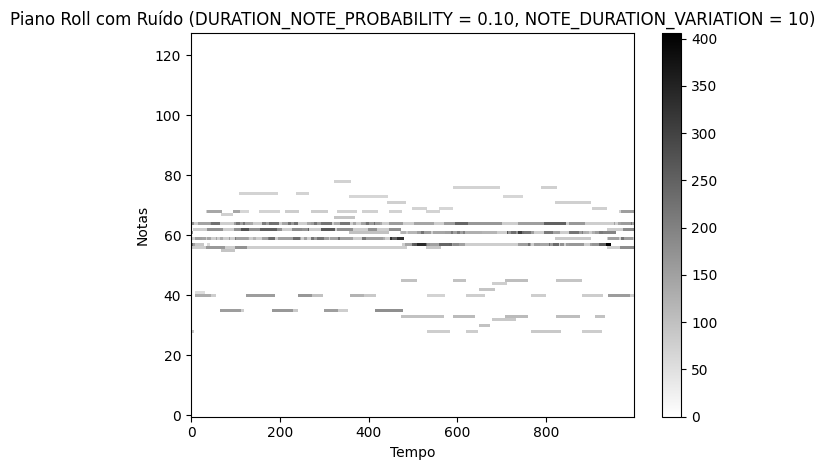

Testando DURATION_NOTE_PROBABILITY = 0.1, NOTE_DURATION_VARIATION = 10
k = 3, Precisão = 0.8442028985507246
k = 5, Precisão = 0.7717391304347826
k = 10, Precisão = 0.6434782608695652


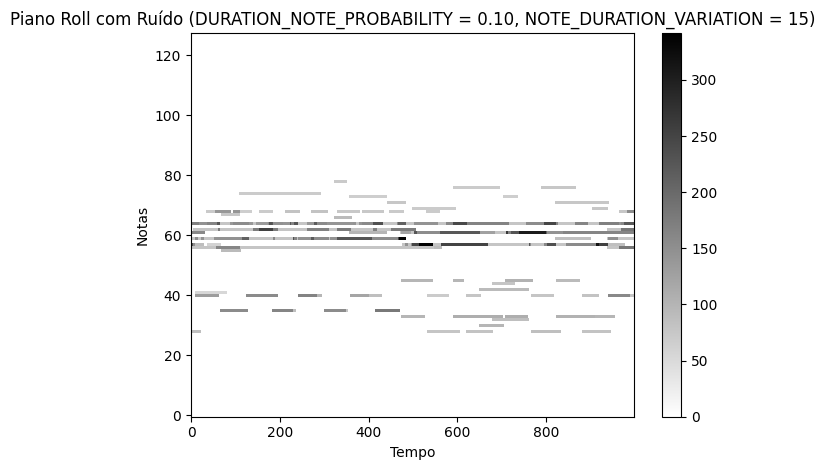

Testando DURATION_NOTE_PROBABILITY = 0.1, NOTE_DURATION_VARIATION = 15
k = 3, Precisão = 0.822463768115942
k = 5, Precisão = 0.7572463768115942
k = 10, Precisão = 0.6253623188405797


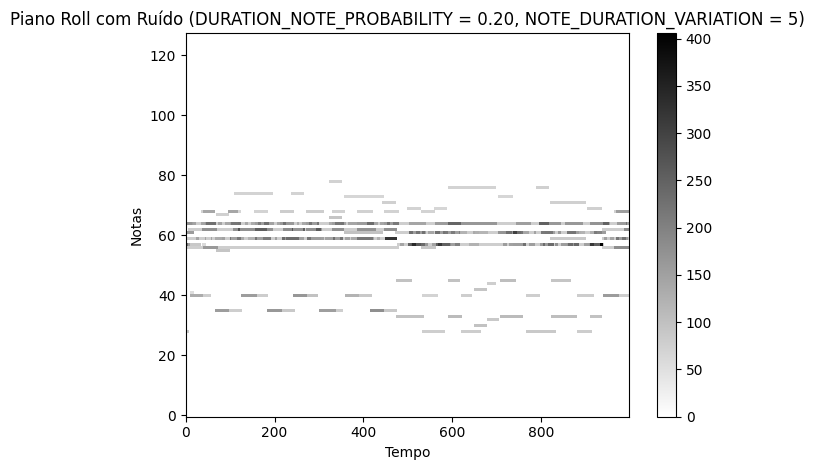

Testando DURATION_NOTE_PROBABILITY = 0.2, NOTE_DURATION_VARIATION = 5
k = 3, Precisão = 0.8478260869565217
k = 5, Precisão = 0.7818840579710145
k = 10, Precisão = 0.644927536231884


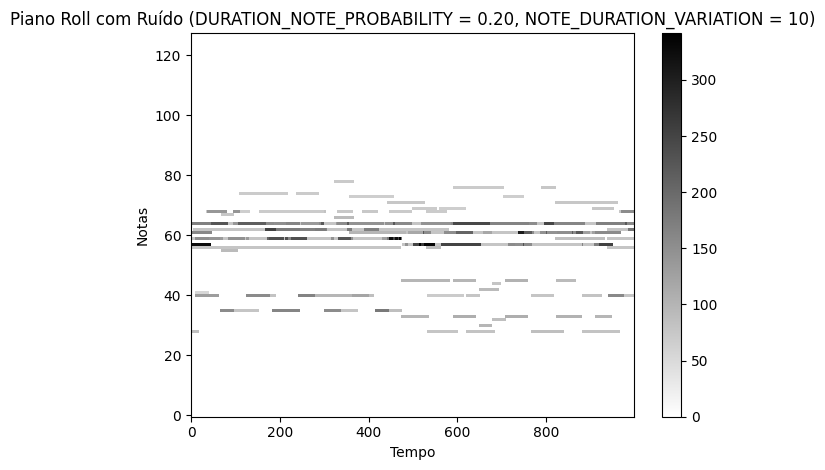

Testando DURATION_NOTE_PROBABILITY = 0.2, NOTE_DURATION_VARIATION = 10
k = 3, Precisão = 0.8140096618357487
k = 5, Precisão = 0.7456521739130435
k = 10, Precisão = 0.6159420289855072


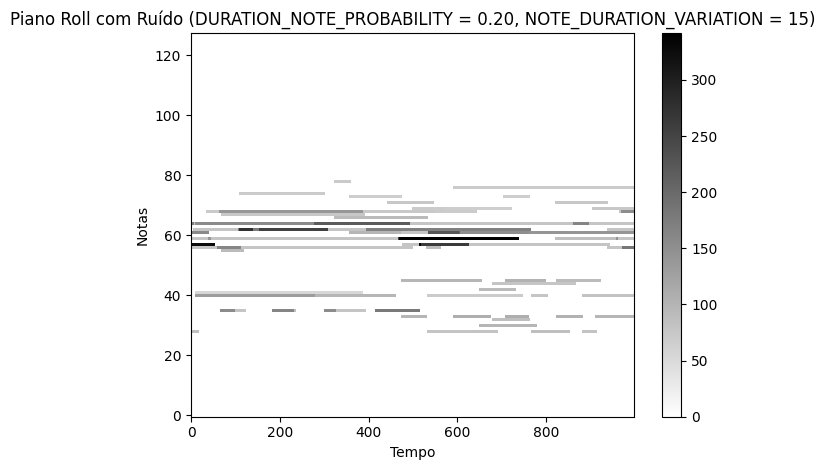

Testando DURATION_NOTE_PROBABILITY = 0.2, NOTE_DURATION_VARIATION = 15
k = 3, Precisão = 0.7524154589371981
k = 5, Precisão = 0.677536231884058
k = 10, Precisão = 0.5539855072463769


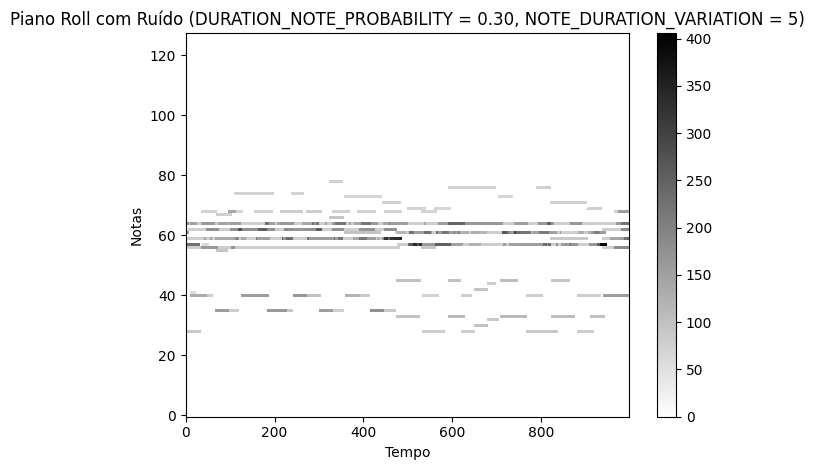

Testando DURATION_NOTE_PROBABILITY = 0.3, NOTE_DURATION_VARIATION = 5
k = 3, Precisão = 0.8502415458937198
k = 5, Precisão = 0.7753623188405797
k = 10, Precisão = 0.6460144927536232


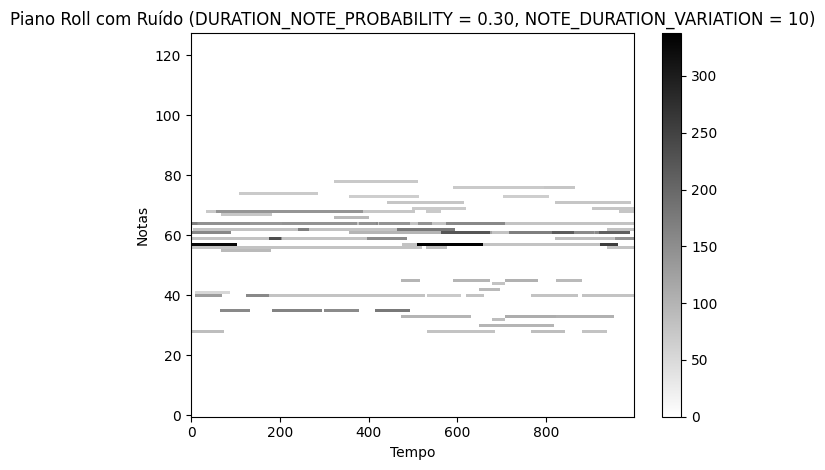

Testando DURATION_NOTE_PROBABILITY = 0.3, NOTE_DURATION_VARIATION = 10
k = 3, Precisão = 0.7560386473429952
k = 5, Precisão = 0.6746376811594202
k = 10, Precisão = 0.5630434782608695


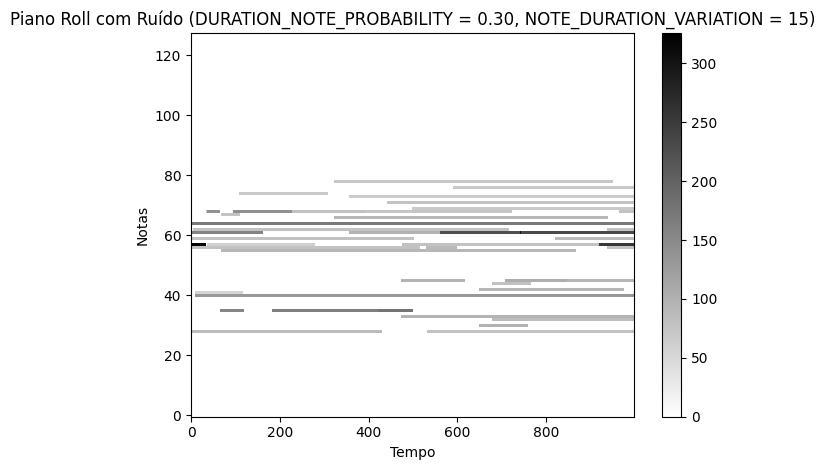

Testando DURATION_NOTE_PROBABILITY = 0.3, NOTE_DURATION_VARIATION = 15
k = 3, Precisão = 0.6908212560386473
k = 5, Precisão = 0.5905797101449275
k = 10, Precisão = 0.4934782608695652


In [81]:
duration_note_probabilities = [0.1, 0.2, 0.3]
note_duration_variations = [5, 10, 15]

for DURATION_NOTE_PROBABILITY in duration_note_probabilities:
    for NOTE_DURATION_VARIATION in note_duration_variations:
        test_df.loc[:, 'noisy_piano_roll'] = test_df['piano_roll_10s'].apply(
        lambda x: add_noise_to_pianoroll(x, fs=FS, note_duration_variation=NOTE_DURATION_VARIATION, 
                                     intensity_variation=INTENSITY_VARIATION, 
                                     random_note_probability=RANDOM_NOTE_PROBABILITY, 
                                     duration_note_probability=DURATION_NOTE_PROBABILITY, 
                                     intense_note_probability=INTENSE_NOTE_PROBABILITY)
        )
        
        print_pianoroll(test_df.iloc[SAMPLE_NUMBER, -1], 'Piano Roll com Ruído (DURATION_NOTE_PROBABILITY = %.2f, NOTE_DURATION_VARIATION = %d)' % (DURATION_NOTE_PROBABILITY, NOTE_DURATION_VARIATION))
        print(f'Testando DURATION_NOTE_PROBABILITY = {DURATION_NOTE_PROBABILITY}, NOTE_DURATION_VARIATION = {NOTE_DURATION_VARIATION}')
        ks = [3, 5, 10]
        for k in ks:
            acertos = 0
            total = k * len(test_df)
            for id in range(len(test_df)):
                tags, y = auto_tagging(id, test_df, model, k, noised=True)

                if len(tags) < k:
                    total -= k - len(tags)
                for tag in tags:
                    if tag in y:
                        acertos += 1
            print(f'k = {k}, Precisão = {acertos/total}')


### Ruído Intensidade

In [82]:
NOTE_DURATION_VARIATION = 0
RANDOM_NOTE_PROBABILITY = 0
DURATION_NOTE_PROBABILITY = 0

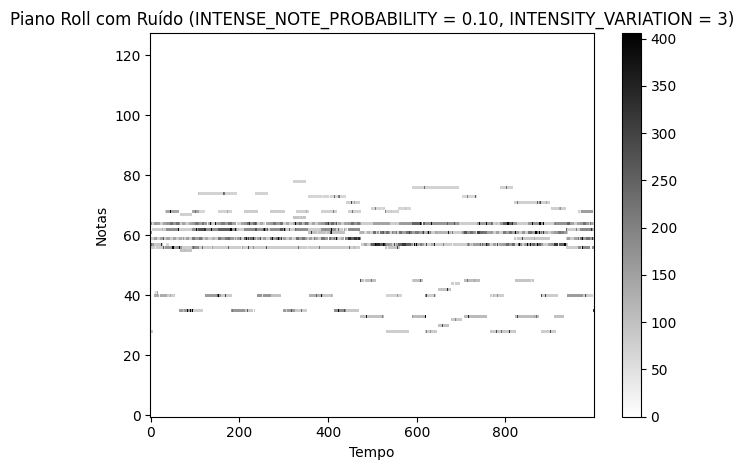

Testando INTENSE_NOTE_PROBABILITY = 0.1, INTENSITY_VARIATION = 3
k = 3, Precisão = 0.8260869565217391
k = 5, Precisão = 0.763768115942029
k = 10, Precisão = 0.6260869565217392


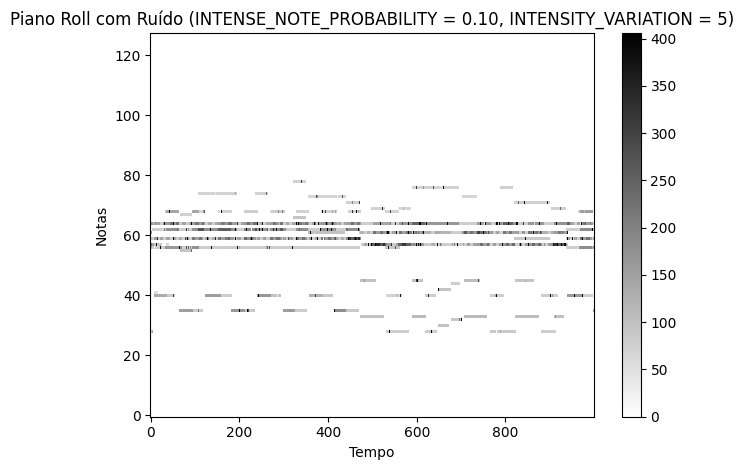

Testando INTENSE_NOTE_PROBABILITY = 0.1, INTENSITY_VARIATION = 5
k = 3, Precisão = 0.8103864734299517
k = 5, Precisão = 0.7536231884057971
k = 10, Precisão = 0.613768115942029


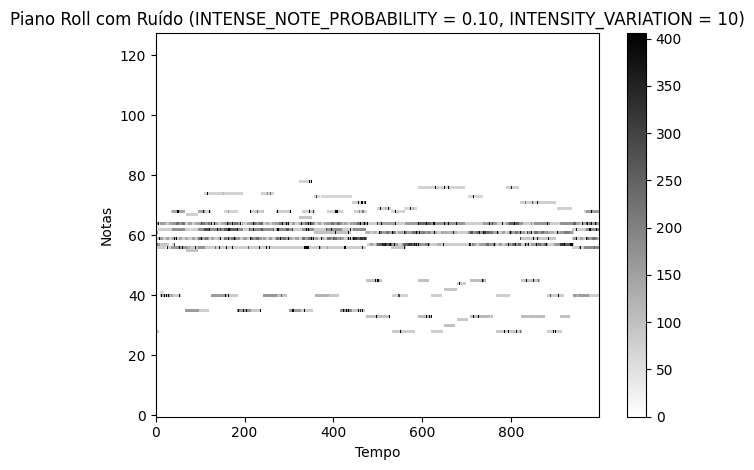

Testando INTENSE_NOTE_PROBABILITY = 0.1, INTENSITY_VARIATION = 10
k = 3, Precisão = 0.8007246376811594
k = 5, Precisão = 0.7355072463768116
k = 10, Precisão = 0.6025362318840579


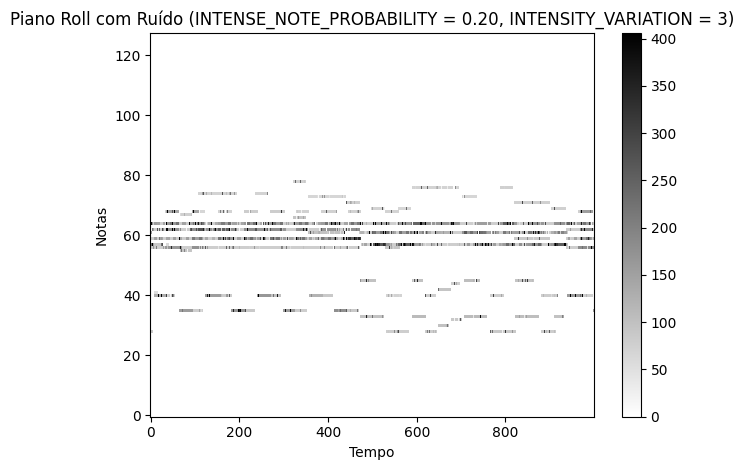

Testando INTENSE_NOTE_PROBABILITY = 0.2, INTENSITY_VARIATION = 3
k = 3, Precisão = 0.8115942028985508
k = 5, Precisão = 0.7478260869565218
k = 10, Precisão = 0.606159420289855


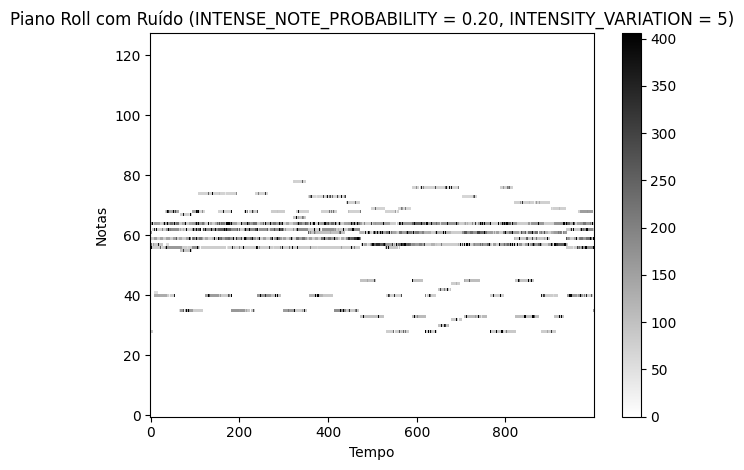

Testando INTENSE_NOTE_PROBABILITY = 0.2, INTENSITY_VARIATION = 5
k = 3, Precisão = 0.7958937198067633
k = 5, Precisão = 0.7202898550724638
k = 10, Precisão = 0.5898550724637681


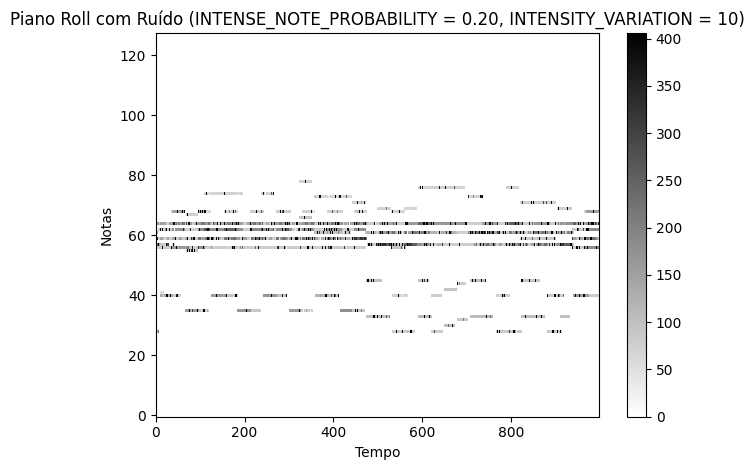

Testando INTENSE_NOTE_PROBABILITY = 0.2, INTENSITY_VARIATION = 10
k = 3, Precisão = 0.7814009661835749
k = 5, Precisão = 0.7043478260869566
k = 10, Precisão = 0.5789855072463768


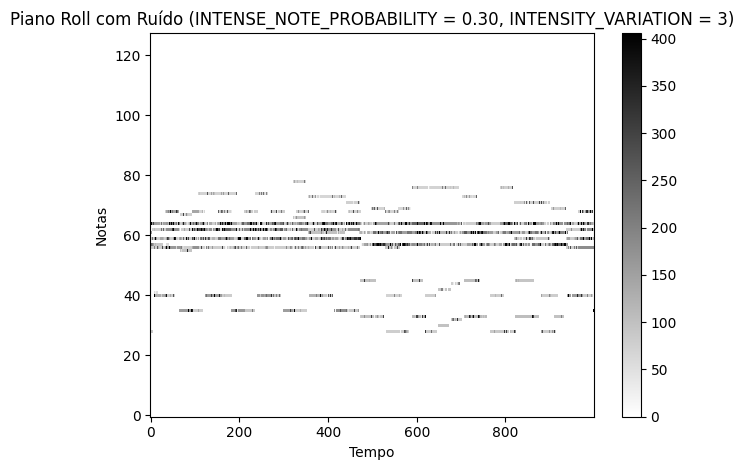

Testando INTENSE_NOTE_PROBABILITY = 0.3, INTENSITY_VARIATION = 3
k = 3, Precisão = 0.7946859903381642
k = 5, Precisão = 0.7289855072463768
k = 10, Precisão = 0.5971014492753624


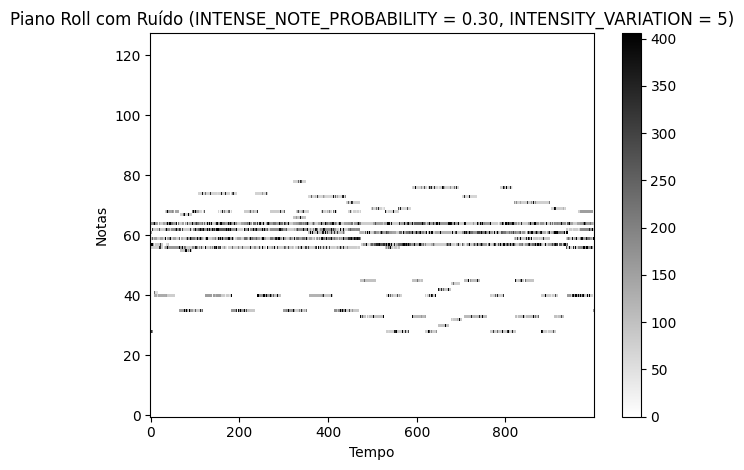

Testando INTENSE_NOTE_PROBABILITY = 0.3, INTENSITY_VARIATION = 5
k = 3, Precisão = 0.7729468599033816
k = 5, Precisão = 0.6956521739130435
k = 10, Precisão = 0.5778985507246377


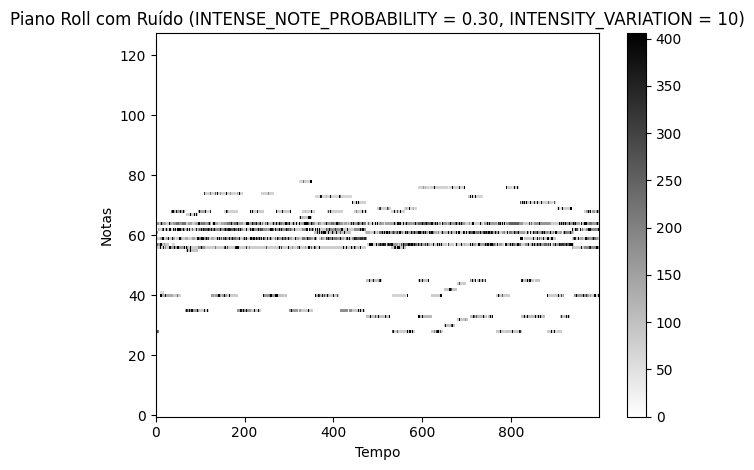

Testando INTENSE_NOTE_PROBABILITY = 0.3, INTENSITY_VARIATION = 10
k = 3, Precisão = 0.7608695652173914
k = 5, Precisão = 0.6891304347826087
k = 10, Precisão = 0.5630434782608695


In [83]:
intense_note_probability = [0.1, 0.2, 0.3]
intensity_variation = [3, 5, 10]

for INTENSE_NOTE_PROBABILITY in intense_note_probability:
    for INTENSITY_VARIATION in intensity_variation:
        test_df.loc[:, 'noisy_piano_roll'] = test_df['piano_roll_10s'].apply(
        lambda x: add_noise_to_pianoroll(x, fs=FS, note_duration_variation=NOTE_DURATION_VARIATION, 
                                     intensity_variation=INTENSITY_VARIATION, 
                                     random_note_probability=RANDOM_NOTE_PROBABILITY, 
                                     duration_note_probability=DURATION_NOTE_PROBABILITY, 
                                     intense_note_probability=INTENSE_NOTE_PROBABILITY)
        )
        
        print_pianoroll(test_df.iloc[SAMPLE_NUMBER, -1], 'Piano Roll com Ruído (INTENSE_NOTE_PROBABILITY = %.2f, INTENSITY_VARIATION = %d)' % (INTENSE_NOTE_PROBABILITY, INTENSITY_VARIATION))
        print(f'Testando INTENSE_NOTE_PROBABILITY = {INTENSE_NOTE_PROBABILITY}, INTENSITY_VARIATION = {INTENSITY_VARIATION}')
        
        ks = [3, 5, 10]
        for k in ks:
            acertos = 0
            total = k * len(test_df)
            for id in range(len(test_df)):
                tags, y = auto_tagging(id, test_df, model, k, noised=True)

                if len(tags) < k:
                    total -= k - len(tags)
                for tag in tags:
                    if tag in y:
                        acertos += 1
            print(f'k = {k}, Precisão = {acertos/total}')


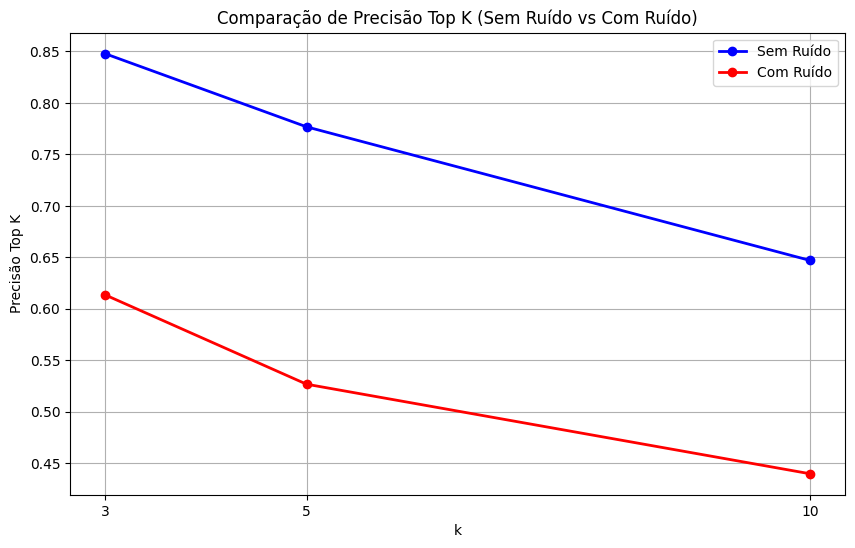

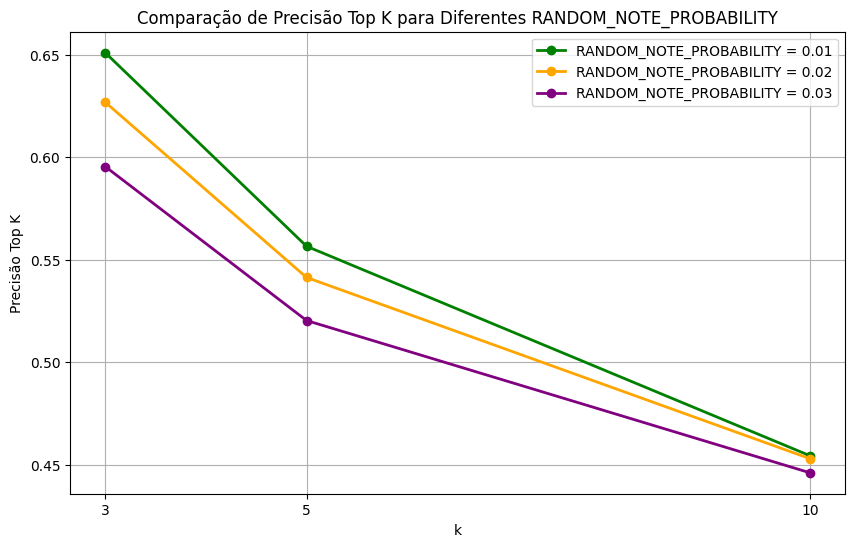

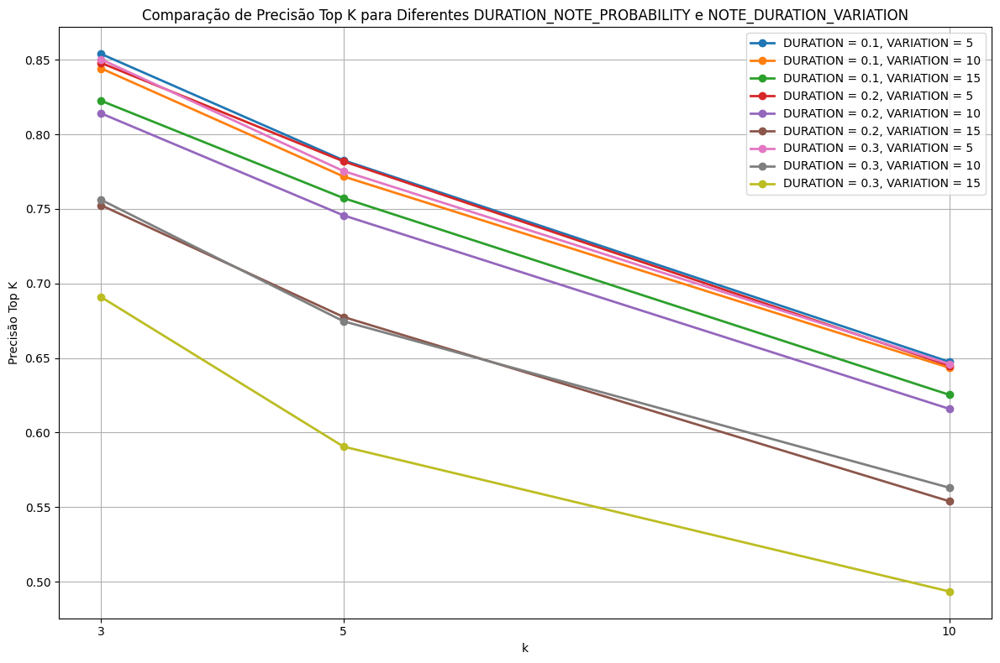

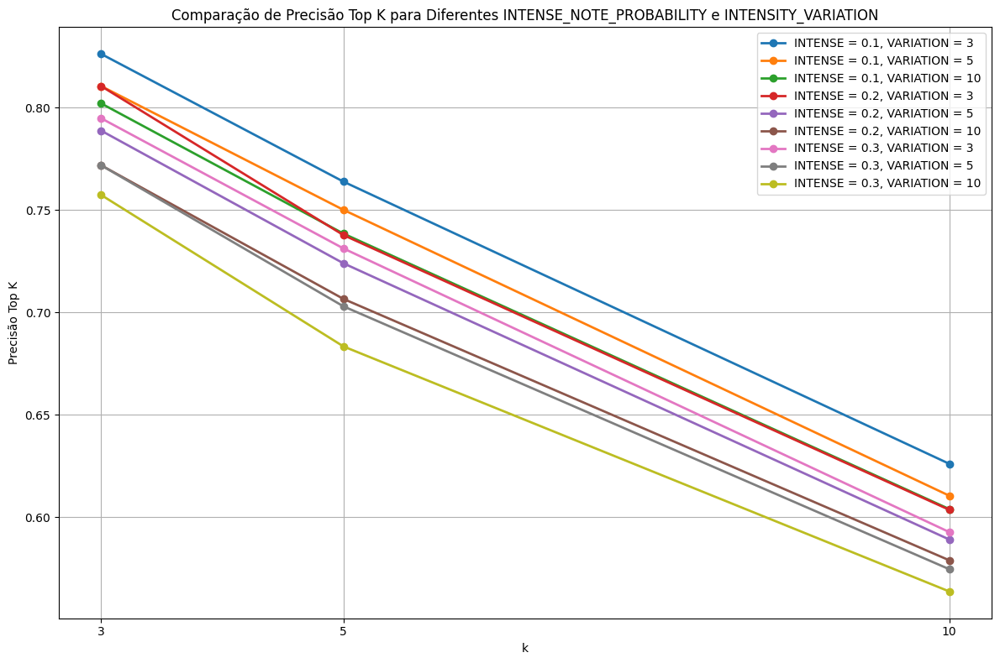

In [85]:
import matplotlib.pyplot as plt

# Dados fornecidos
sem_ruido = {
    3: 0.8478260869565217,
    5: 0.7768115942028986,
    10: 0.6471014492753623
}

com_ruido = {
    3: 0.6135265700483091,
    5: 0.5268115942028986,
    10: 0.4398550724637681
}

# Gráfico comparando "Sem Ruído" com "Com Ruído"
k_values = [3, 5, 10]
precisoes_sem_ruido = list(sem_ruido.values())
precisoes_com_ruido = list(com_ruido.values())

plt.figure(figsize=(10, 6))
plt.plot(k_values, precisoes_sem_ruido, label='Sem Ruído', marker='o', color='blue', linestyle='-', linewidth=2)
plt.plot(k_values, precisoes_com_ruido, label='Com Ruído', marker='o', color='red', linestyle='-', linewidth=2)
plt.xlabel('k')
plt.ylabel('Precisão Top K')
plt.title('Comparação de Precisão Top K (Sem Ruído vs Com Ruído)')
plt.xticks([3, 5, 10])
plt.legend()
plt.grid(True)
plt.show()


# Dados para RANDOM_NOTE_PROBABILITY
random_note_prob = {
    0.01: [0.6509661835748792, 0.5565217391304348, 0.4543478260869565],
    0.02: [0.6268115942028986, 0.5413043478260869, 0.4528985507246377],
    0.03: [0.5954106280193237, 0.5202898550724637, 0.4460144927536232]
}

# Gráfico comparando RANDOM_NOTE_PROBABILITY
prob_values = list(random_note_prob.keys())
precisoes_01 = [random_note_prob[0.01][i] for i in range(3)]
precisoes_02 = [random_note_prob[0.02][i] for i in range(3)]
precisoes_03 = [random_note_prob[0.03][i] for i in range(3)]

plt.figure(figsize=(10, 6))
plt.plot(k_values, precisoes_01, label='RANDOM_NOTE_PROBABILITY = 0.01', marker='o', color='green', linestyle='-', linewidth=2)
plt.plot(k_values, precisoes_02, label='RANDOM_NOTE_PROBABILITY = 0.02', marker='o', color='orange', linestyle='-', linewidth=2)
plt.plot(k_values, precisoes_03, label='RANDOM_NOTE_PROBABILITY = 0.03', marker='o', color='purple', linestyle='-', linewidth=2)
plt.xlabel('k')
plt.ylabel('Precisão Top K')
plt.title('Comparação de Precisão Top K para Diferentes RANDOM_NOTE_PROBABILITY')
plt.xticks([3, 5, 10])
plt.legend()
plt.grid(True)
plt.show()


# Dados para DURATION_NOTE_PROBABILITY e NOTE_DURATION_VARIATION
duration_variation_data = {
    (0.1, 5): [0.8538647342995169, 0.782608695652174, 0.6474637681159421],
    (0.1, 10): [0.8442028985507246, 0.7717391304347826, 0.6434782608695652],
    (0.1, 15): [0.822463768115942, 0.7572463768115942, 0.6253623188405797],
    (0.2, 5): [0.8478260869565217, 0.7818840579710145, 0.644927536231884],
    (0.2, 10): [0.8140096618357487, 0.7456521739130435, 0.6159420289855072],
    (0.2, 15): [0.7524154589371981, 0.677536231884058, 0.5539855072463769],
    (0.3, 5): [0.8502415458937198, 0.7753623188405797, 0.6460144927536232],
    (0.3, 10): [0.7560386473429952, 0.6746376811594202, 0.5630434782608695],
    (0.3, 15): [0.6908212560386473, 0.5905797101449275, 0.4934782608695652]
}

# Gráfico comparando DURATION_NOTE_PROBABILITY e NOTE_DURATION_VARIATION
plt.figure(figsize=(12, 8))
for (duration, variation), precisao in duration_variation_data.items():
    label = f'DURATION = {duration}, VARIATION = {variation}'
    plt.plot(k_values, precisao, label=label, marker='o', linestyle='-', linewidth=2)

plt.xlabel('k')
plt.ylabel('Precisão Top K')
plt.title('Comparação de Precisão Top K para Diferentes DURATION_NOTE_PROBABILITY e NOTE_DURATION_VARIATION')
plt.xticks([3, 5, 10])
plt.legend(fontsize=10, loc='upper right')
plt.grid(True)
plt.tight_layout()
plt.show()


# Dados para INTENSE_NOTE_PROBABILITY e INTENSITY_VARIATION
intensity_variation_data = {
    (0.1, 3): [0.8260869565217391, 0.763768115942029, 0.6260869565217392],
    (0.1, 5): [0.8103864734299517, 0.75, 0.6105072463768116],
    (0.1, 10): [0.8019323671497585, 0.7384057971014493, 0.6039855072463768],
    (0.2, 3): [0.8103864734299517, 0.7376811594202899, 0.6036231884057971],
    (0.2, 5): [0.788647342995169, 0.7239130434782609, 0.5891304347826087],
    (0.2, 10): [0.7717391304347826, 0.7065217391304348, 0.5789855072463768],
    (0.3, 3): [0.7946859903381642, 0.731159420289855, 0.5927536231884057],
    (0.3, 5): [0.7717391304347826, 0.7028985507246377, 0.5746376811594203],
    (0.3, 10): [0.7572463768115942, 0.6833333333333333, 0.563768115942029]
}

# Gráfico comparando INTENSE_NOTE_PROBABILITY e INTENSITY_VARIATION
plt.figure(figsize=(12, 8))
for (intense_prob, intensity_var), precisao in intensity_variation_data.items():
    label = f'INTENSE = {intense_prob}, VARIATION = {intensity_var}'
    plt.plot(k_values, precisao, label=label, marker='o', linestyle='-', linewidth=2)

plt.xlabel('k')
plt.ylabel('Precisão Top K')
plt.title('Comparação de Precisão Top K para Diferentes INTENSE_NOTE_PROBABILITY e INTENSITY_VARIATION')
plt.xticks([3, 5, 10])
plt.legend(fontsize=10, loc='upper right')
plt.grid(True)
plt.tight_layout()
plt.show()
